# <a id='toc1_'></a>[Image Classification - Street view House Number (SVHN)](#toc0_)

<hr style="border:1px dashed #888;">
<div style="max-width: 700px; line-height: 1.5; text-align: justify;">


**Introduction**

In this project, the author sourced images from hugging face, more specifically, the Stanford SVHN dataset. This notebook will showcase the authors analysis process and how they took an initially poor performing model and fine-tuned it. For more information regarding supporting documents please refer to the GitHub link mentioned in the project overview table below. If you have any questions or would like to contact me, please feel free to connect with me on LinkedIn.

**Project Overview**

|Feature  |  Description|
|---------|---------|
|Author     |    Matthew Prinsloo      |
|Task     |    Multiclass image classifcation using street view house      |
|Company Document    | MAPrinsloo - SVHN Image Classification CNN.pdf    |
|Dataset Link     |https://huggingface.co/datasets/ufldl-stanford/svhn         |
|Parquet files     | https://huggingface.co/datasets/ufldl-stanford/svhn/tree/main/cropped_digits        |
|Environment Setup     |    enironment.tf-gpu-wsl.yml      |
|GitHub     |     https://github.com/MAPrinsloo/SVHN_CNN_PDAN8412-POE-S2P3    |
|LinkedIn     |    [https://www.linkedin.com/in/matthew-prinsloo-b01b262b7/](https://www.linkedin.com/in/matthew-prinsloo-b01b262b7/)     |




Please bare in my that this file is treated as an academic document and may at times contain superfluous comments. With this in mind, the student attempted to keep longer discussions regarding the code to the company document. This document can be found attached in the same directory that this jupyter notebook is located.
</div>

<hr style="border:1px dashed #888;">


**Table of contents**<a id='toc0_'></a>    
- [Image Classification - Street view House Number (SVHN)](#toc1_)    
- [Initialising](#toc2_)    
  - [Imports](#toc2_1_)    
  - [Loading Data](#toc2_2_)    
- [Exploratory Data Analysis (EDA)](#toc3_)    
  - [Cleaning the Dataframe](#toc3_1_)    
- [Pre-processing](#toc4_)    
  - [Instantiating Pipelines](#toc4_1_)    
    - [Image Quality Pipeline](#toc4_1_1_)    
      - [Declaring Pipeline](#toc4_1_1_1_)    
      - [Parameter Tuning for Image Quality Assessment](#toc4_1_1_2_)    
    - [Pre-processing Images Pipeline](#toc4_1_2_)    
      - [Declaring Pipeline](#toc4_1_2_1_)    
      - [Fine-tune Sharpening Variables](#toc4_1_2_2_)    
  - [Executing Pipelines](#toc4_2_)    
- [Splitting the Data for Testing & Training](#toc5_)    
- [Attempt 1](#toc6_)    
  - [Datagen](#toc6_1_)    
  - [Compiling Custom CNN](#toc6_2_)    
  - [Training](#toc6_3_)    
  - [Test and Evalauate](#toc6_4_)    
- [Attempt 2](#toc7_)    
  - [Datagen](#toc7_1_)    
  - [Compiling Custom CNN](#toc7_2_)    
  - [Training](#toc7_3_)    
  - [Test and Evaluate](#toc7_4_)    
- [Manually Testing - GUI](#toc8_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

---

# <a id='toc2_'></a>[Initialising](#toc0_)

<hr style="border:1px dashed #888;">

<div style="max-width: 700px; line-height: 1.5">

**Introduction**

This section focuses on creating an environment with the necessary variables for executing the code in this jupyter 
notebook. This includes:

- **Imports** - The imports needed for running the code
- **Loading Data** - Loads the data from the parquet files into a spark dataframe
- **Locally Saving Images** - Saves the images to a local directory. Run the SaveRawImagesToDisk.py file.

- **df**: 'extra-00000-of-00002.parquet' + 'extra-00001-of-00002.parquet'
- **df_images**: reading from custom csv created from converting encoded data to images

Some of the content here does not represent the order in which they were addressed. They are however necessary to run
most if not all of the code at any point in this notebook. </div>


<hr style="border:1px dashed #888;">

## <a id='toc2_1_'></a>[Imports](#toc0_)

In [1]:
#-----------------------------------------------------------------------------------------------------------------------#
# region pyspark
# Data manipulation
from pyspark.sql import SparkSession
from pyspark.sql.functions import col
# endregion

In [2]:
#-----------------------------------------------------------------------------------------------------------------------#
# region sklearn
# Model evaluation reports
from sklearn.metrics import classification_report, confusion_matrix
# Image quality evaluation and sharpening
from skimage.metrics import structural_similarity as ssim
from skimage import img_as_ubyte
from skimage.filters import unsharp_mask
# endregion

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
#-----------------------------------------------------------------------------------------------------------------------#
# region Misc
# Data visualisation and manipulation = used for saving the data
import pandas as pd
# Data visualisation
import matplotlib.pyplot as plt  
# Numerical computations
import numpy as np  
# More data visualisation
import seaborn as sns  
# Handling the binary data
import io
from io import BytesIO
# File and directory handling
import os
import shutil
from pathlib import Path
# Random shuffeling
import random
# image processing
from PIL import Image
from IPython.display import Image as DisplayImage
# endregion

In [4]:
#-----------------------------------------------------------------------------------------------------------------------#
# region Tensorflow
# Model checkpoints and evaluating the model during training using tensorboard
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard
# Import the models and layers modules
from tensorflow.keras import models, layers
# Used for sequential data models and loading data
from tensorflow.keras.models import load_model
# The optimiser function
from tensorflow.keras.preprocessing.image import ImageDataGenerator
# endregion

2025-10-26 18:12:10.601176: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [5]:
#-----------------------------------------------------------------------------------------------------------------------#
# Checking to see if GPU is detected
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


## <a id='toc2_2_'></a>[Loading Data](#toc0_)

In [6]:
#-----------------------------------------------------------------------------------------------------------------------#
# Creating the spark session
spark = SparkSession.builder.appName("number_prediction").getOrCreate()

your 131072x1 screen size is bogus. expect trouble
25/10/26 18:12:13 WARN Utils: Your hostname, Matilda resolves to a loopback address: 127.0.1.1; using 10.255.255.254 instead (on interface lo)
25/10/26 18:12:13 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
25/10/26 18:12:14 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


In [7]:
#-----------------------------------------------------------------------------------------------------------------------#
# Creating a spark dataframe
df = spark.read.parquet('extra-00000-of-00002.parquet', 'extra-00001-of-00002.parquet')

# <a id='toc3_'></a>[Exploratory Data Analysis (EDA)](#toc0_)

<hr style="border:1px dashed #888;">

**Introduction - Exploratory Data Analysis (EDA)**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
The analysis process begins with the exploration of the collected data in the Exploratory Data Analysis (EDA) section. In this section, the student gained some important insights into the nature of the SVHN dataset. The student was required to make use of spark throughout the data analysis process as far as possible.
</div>

For further information regarding how the data was explored please refer to:
| Item      | Description |
|------------|-------------|
| Document   | MAPrinsloo - SVHN Image Classification CNN.pdf |
| Section    | "4.2 Exploratory Data Analysis (EDA)" |
| Page       | 10 |
<hr style="border:1px dashed #888;">


In [8]:
#-----------------------------------------------------------------------------------------------------------------------#
# Checking the schema and all the column names
df.printSchema()
#-----------------------------------------------------------------------------------------------------------------------#
# prelimenary check on the data
print("Dataframe imported from parquet into spark")
df.show(5)
# The image column is a tuple so we need to select each part to peer in
print("Image bytes")
df.select("image.bytes").show(5)
print("Image path")
df.select("image.path").show(5)

root
 |-- image: struct (nullable = true)
 |    |-- bytes: binary (nullable = true)
 |    |-- path: string (nullable = true)
 |-- label: long (nullable = true)

Dataframe imported from parquet into spark
+--------------------+-----+
|               image|label|
+--------------------+-----+
|{[89 50 4E 47 0D ...|    4|
|{[89 50 4E 47 0D ...|    7|
|{[89 50 4E 47 0D ...|    8|
|{[89 50 4E 47 0D ...|    7|
|{[89 50 4E 47 0D ...|    1|
+--------------------+-----+
only showing top 5 rows

Image bytes
+--------------------+
|               bytes|
+--------------------+
|[89 50 4E 47 0D 0...|
|[89 50 4E 47 0D 0...|
|[89 50 4E 47 0D 0...|
|[89 50 4E 47 0D 0...|
|[89 50 4E 47 0D 0...|
+--------------------+
only showing top 5 rows

Image path
+----+
|path|
+----+
|NULL|
|NULL|
|NULL|
|NULL|
|NULL|
+----+
only showing top 5 rows



In [9]:
#-----------------------------------------------------------------------------------------------------------------------#
# Check for null values in label
df_query = df.filter(df["label"].isNotNull())
num_null_labels = df_query.count()

# Check for null values in image.bytes
df_query = df.filter(df["image.bytes"].isNotNull())
num_null_imagesBytes = df_query.count()

# Check for null values in image.path
df_query = df.filter(df["image.path"].isNotNull())
num_null_imagesPath = df_query.count()

# Check for the number of duplicates by dropping and comparing against original size
df_query = df.select("image.bytes", "image.path", "label").dropDuplicates()
num_duplicate_images = df.count() - df_query.count()

In [10]:
#-----------------------------------------------------------------------------------------------------------------------#
# Print Summary of exploratorations
print(f"Total number of rows in the dataframe {df.count()}")
print(f"number of valid labels {num_null_labels}")
print(f"number of valid image bytes {num_null_imagesBytes}")
print(f"number of valid image paths {num_null_imagesPath}")
print(f"number of duplicate images {num_duplicate_images}")

Total number of rows in the dataframe 531131
number of valid labels 531131
number of valid image bytes 531131
number of valid image paths 0
number of duplicate images 1


In [11]:
#-----------------------------------------------------------------------------------------------------------------------#
# Print the class distribution of the dataframe
df_query = df.select("label")
total_rows = df_query.count()
category_distribution = df_query.groupBy("label").count()
category_distribution_with_percentage = category_distribution.withColumn(
    "percentage", (col("count") / total_rows) * 100
)
total_categories = category_distribution_with_percentage.count()
category_distribution_with_percentage.orderBy("percentage", ascending=False).show(total_categories,truncate=False)

+-----+-----+------------------+
|label|count|percentage        |
+-----+-----+------------------+
|1    |90560|17.050407526580074|
|2    |74740|14.071857978540134|
|3    |60765|11.440680359459341|
|5    |53490|10.070961777791167|
|4    |50633|9.533053050942234 |
|0    |45550|8.576038679723082 |
|7    |43997|8.283643771498934 |
|6    |41582|7.82895368562558  |
|8    |35358|6.657114723109742 |
|9    |34456|6.487288446729715 |
+-----+-----+------------------+



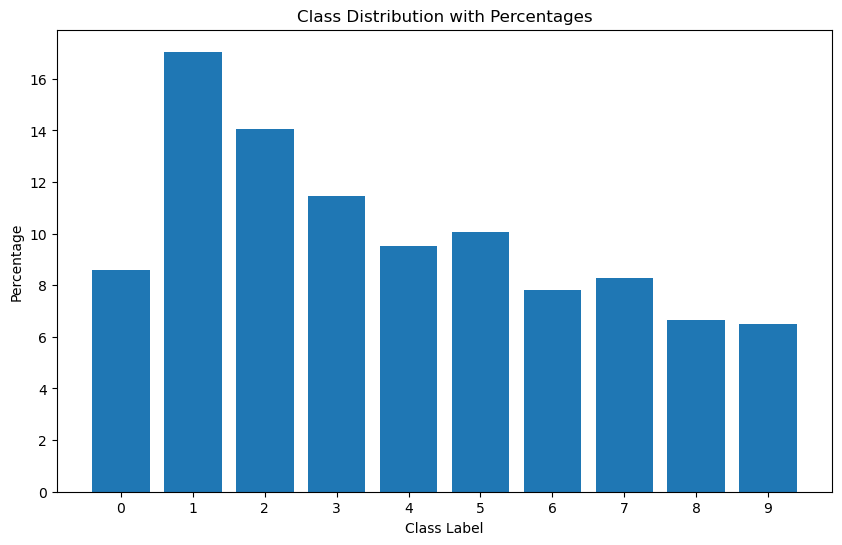

In [12]:

#-----------------------------------------------------------------------------------------------------------------------#
# Visualise the distribution as a bar graph
# Convert DataFrame to Pandas
category_distribution_pd = category_distribution_with_percentage.toPandas()

# Sort the data by label to ensure the labels align correctly with the bars
category_distribution_pd = category_distribution_pd.sort_values(by="label")

# Plot a bar graph
plt.figure(figsize=(10, 6))
plt.bar(category_distribution_pd['label'].astype(str), category_distribution_pd['percentage'])
plt.xlabel('Class Label')
plt.ylabel('Percentage')
plt.title('Class Distribution with Percentages')

# Ensure that all class labels appear
plt.xticks(ticks=range(len(category_distribution_pd['label'])), labels=category_distribution_pd['label'].astype(str))

# Display the plot
plt.show()


<hr style="border:1px dashed #888;">

**Discussion - Exploratory Data Analysis(EDA)**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
Easiest way to balance the dataset would be to employ undersampling. In this case we would take the lowest occuring class and use that as the maximum value for all other classes. The class with the least value, as seen from the EDA is "9" with a total of 34,456 entries. With this in mind, the student would still be able to train a model with a maximum of ~344,560 entries (without a training sample). Howerver, seeing that the minimum images required for this task is 100,000 the student could alternatively look to selecting 10,000 images of the best quality for each class. This would ensure a balanced dataset while keeping the quality of data up. Garbage in garbage out.
</div>


<hr style="border:1px dashed #888;">


## <a id='toc3_1_'></a>[Cleaning the Dataframe](#toc0_)


<hr style="border:1px dashed #888;">

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">

**Discussion - Cleaning the Dataframe**

Can drop image.path as it does not contain any information. Seeing that path is being dropped, there is no need to 
maintain the nested structure. The variable "image.bytes" will be brought up the shcema. There were no null values so
there is no need to drop them. There was one duplicate in the dataframe, this will be dropped. There is some imablance
to the dataset but it is not major. The will explore how the models performance will be influenced by working with 
both a stratifeid and balanced dataframe. With the EDA in mind, the following cell will perform the actions needed to
clean the dataframe.</div>


<hr style="border:1px dashed #888;">

In [8]:
#-----------------------------------------------------------------------------------------------------------------------#
# Create clean dataframe
df_clean = df.select("image", "label").dropDuplicates()
df_clean = df_clean.withColumn("image", col("image").dropFields("path"))
df_clean = df_clean.withColumn("bytes", col("image.bytes")).drop("image")
df_clean.printSchema()
print (f"Number of entries: {df_clean.count()}")

root
 |-- label: long (nullable = true)
 |-- bytes: binary (nullable = true)



Number of entries: 531130


In [14]:
#-----------------------------------------------------------------------------------------------------------------------#
# Print the class distribution of the dataframe
df_query = df_clean.select("label")
total_rows = df_query.count()
category_distribution = df_query.groupBy("label").count()
category_distribution_with_percentage = category_distribution.withColumn(
    "percentage", (col("count") / total_rows) * 100
)
total_categories = category_distribution_with_percentage.count()
category_distribution_with_percentage.orderBy("percentage", ascending=False).show(total_categories,truncate=False)

25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on RowBasedKeyValueBatch. Will not spill but return 0.
25/10/26 16:54:53 WARN RowBasedKeyValueBatch: Calling spill() on

+-----+-----+------------------+
|label|count|percentage        |
+-----+-----+------------------+
|1    |90559|17.05025135089338 |
|2    |74740|14.071884472727959|
|3    |60765|11.440701899723232|
|5    |53490|10.070980739178733|
|4    |50633|9.533070999566961 |
|0    |45550|8.576054826501986 |
|7    |43997|8.283659367763072 |
|6    |41582|7.8289684258091246|
|8    |35358|6.6571272569804   |
|9    |34456|6.487300660855158 |
+-----+-----+------------------+



# <a id='toc4_'></a>[Pre-processing](#toc0_)


<hr style="border:1px dashed #888;">

**Discussion - Pre-processing**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
This section will focus on preparing the image data for training, validation and testing. The images will first have 
their quality evaluated and from their they will be pre-processed.
Check image quality:

- Blur
- Constrast
- Brightness
- Compression
                        
Pre-processing:         
- Normalised
- RGB
- 32x32

For further information regarding how pre-processing was implemeted, please refer to:

| Item | Description |
|---------|---------|
|Document     |   MAPrinsloo - SVHN Image Classification CNN.pdf      |
|Section     |    4.4 Pipelines     |
|Page     |    13     |
 
</div>


<hr style="border:1px dashed #888;">

## <a id='toc4_1_'></a>[Instantiating Pipelines](#toc0_)

### <a id='toc4_1_1_'></a>[Image Quality Pipeline](#toc0_)

#### <a id='toc4_1_1_1_'></a>[Declaring Pipeline](#toc0_)


<hr style="border:1px dashed #888;">

**Discussion - Declaring Pipeline**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
The default values within the methods below are a result of fine-tuning the quality parameters.
</div>


<hr style="border:1px dashed #888;">

In [9]:
#-----------------------------------------------------------------------------------------------------------------------#
# Image quality evaluation functions

# Function to calculate blur (Laplacian variance using NumPy)
def is_blurry(image, threshold=140000):
    # Convert to grayscale using Pillow
    gray_image = image.convert('L')
    gray_image = np.array(gray_image)
    
    # Compute the Laplacian by applying a simple kernel (since cv2.Laplacian is not available)
    laplacian = np.gradient(gray_image)[0] ** 2 + np.gradient(gray_image)[1] ** 2
    variance = laplacian.var()
    return variance, variance < threshold
# https://www.geeksforgeeks.org/how-to-check-for-blurry-images-in-your-dataset-using-the-laplacian-method/

# Function to calculate contrast (std deviation of pixel values)
def has_low_contrast(image, contrast_threshold=17):
    # Convert to grayscale using Pillow
    gray_image = image.convert('L')
    gray_image = np.array(gray_image)
    
    # Calculate contrast as the standard deviation of pixel values
    contrast = gray_image.std()
    return contrast, contrast < contrast_threshold
# https://stackoverflow.com/questions/52094592/calculate-contrast-of-a-color-imagergb

# Function to calculate brightness (mean pixel value)
def is_overly_bright_or_dark(image, min_brightness=50, max_brightness=200):
    # Convert to grayscale using Pillow
    gray_image = image.convert('L')
    gray_image = np.array(gray_image)
    
    # Calculate brightness as the mean pixel value
    mean_brightness = np.mean(gray_image)
    return mean_brightness, mean_brightness < min_brightness or mean_brightness > max_brightness
# https://stackoverflow.com/questions/3490727/what-are-some-methods-to-analyze-image-brightness-using-python

# Function to check compression artefacts using SSIM
def has_compression_artifacts(image, threshold=0.95):
    # Convert the image to a numpy array for processing
    image_array = np.array(image)

    # Compress the image
    buffered = BytesIO()
    image.save(buffered, format="JPEG", quality=50)  # Apply compression

    # Decompress the image
    decompressed_image = Image.open(buffered)
    decompressed_image_array = np.array(decompressed_image)
    
    # Compute SSIM between the original and compressed image
    ssim_index, _ = ssim(image_array, decompressed_image_array, full=True, multichannel=True)
    
    return ssim_index, ssim_index < threshold
# https://scikit-image.org/docs/stable/auto_examples/transform/plot_ssim.html


In [31]:
#-----------------------------------------------------------------------------------------------------------------------#
# Function to evaluate image quality and take action
def evaluate_and_copy_image(image, image_path, output_directory, class_label):
    # Step 1: Check if the image is blurry
    blur_variance, is_blurry_result = is_blurry(image, threshold=blur_threshold) # Pass the tuned threshold
    if is_blurry_result:
        print(f"Image is blurry (variance: {blur_variance}), skipping...")
        return False
    
    # Step 2: Check if the image has low contrast
    contrast_value, has_low_contrast_result = has_low_contrast(image, contrast_threshold=contrast_threshold) # Pass tuned threshold
    if has_low_contrast_result:
        print(f"Image has low contrast (contrast: {contrast_value}), skipping...")
        return False
    
    # Step 3: Check if the image is overly bright or dark
    brightness_value, is_overly_bright_or_dark_result = is_overly_bright_or_dark(image, min_brightness=brightness_min, max_brightness=brightness_max) # Pass tuned thresholds
    if is_overly_bright_or_dark_result:
        print(f"Image is overly bright or dark (brightness: {brightness_value}), skipping...")
        return False
    
    # Step 4: Check if the image has compression artifacts
    ssim_index, has_artifacts_result = has_compression_artifacts(image, threshold=ssim_threshold) # Pass tuned threshold
    if has_artifacts_result:
        print(f"Image has compression artifacts (SSIM: {ssim_index}), skipping...")
        return False
    
    # If the image passes all checks, construct the full destination path and copy it
    class_output_dir = os.path.join(output_directory, str(class_label)) # Create class-specific subdirectory
    os.makedirs(class_output_dir, exist_ok=True) # Ensure the class subdirectory exists

    # Get just the filename from the source path
    filename = os.path.basename(image_path)
    final_dest_path = os.path.join(class_output_dir, filename)

    shutil.copy(image_path, final_dest_path)
    print(f"Image copied to {final_dest_path}")
    
    return True

In [11]:
#-----------------------------------------------------------------------------------------------------------------------#
# Function to process images in each class directory
def process_class_images(class_dir, class_label, output_directory, max_images_per_class=10_000):
    image_count = 0

    # Iterate over the images in the class directory
    for filename in os.listdir(class_dir):
        if filename.endswith(('.png')):
            image_path = os.path.join(class_dir, filename)

            # Read image
            image = Image.open(image_path)

            if image is None:
                continue  # Skip if the image could not be loaded

            # Evaluate the image and copy if it passes the quality checks
            if evaluate_and_copy_image(image, image_path, output_directory, class_label):
                image_count += 1

            # Stop after processing 10,000 images for this class
            if image_count >= max_images_per_class:
                print(f"Processed {image_count} images for class {class_label}. Moving to the next class.")
                break

In [12]:
#-----------------------------------------------------------------------------------------------------------------------#
# Pipeline function to process all classes
def process_all_classes(base_directory, output_directory, max_images_per_class=10_000):
    for class_label in range(10):
        class_dir = os.path.join(base_directory, str(class_label))

        if not os.path.exists(class_dir):
            print(f"Class {class_label} directory not found. Skipping...")
            continue

        print(f"Processing images for class {class_label}...")
        process_class_images(class_dir, class_label, output_directory, max_images_per_class)

#### <a id='toc4_1_1_2_'></a>[Parameter Tuning for Image Quality Assessment](#toc0_)


<hr style="border:1px dashed #888;">

**Discussion - Parameter Tuning for Image Quality Assessment**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
The author manually selected images they deemed to be of good and bad quality. Once a good and bad image was selected for each of the categories, the author then analysed the quality of said images. The derived quality metrics were then used to fine-tune the parameters for the image quality pipeline. The resulting parameters from this section will be used as default values within the pipeline. The parameters were tuned in a way that ensured that good images only returned FALSE and bad images had at least one parameter return TRUE. Returning true should indicate a negative trait for a parameter has been detected.

</div>


<hr style="border:1px dashed #888;">

In [13]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuned Parameters for Images Quality Assessment
blur_threshold = 140_000
contrast_threshold = 17
brightness_min = 50
brightness_max = 200
ssim_threshold = 0.95

In [14]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning image evaluation metrics
# Load images
src_file = "fine_tune_quality"
image_paths = [
                f"{src_file}/BAD_0_image_802.png",
                f"{src_file}/BAD_1_image_577.png",
                f"{src_file}/BAD_2_image_453.png",
                f"{src_file}/BAD_3_image_210.png",
                f"{src_file}/BAD_4_image_198.png",
                f"{src_file}/BAD_5_image_796.png",
                f"{src_file}/BAD_6_image_598.png",
                f"{src_file}/BAD_7_image_2152.png",
                f"{src_file}/BAD_8_image_5048.png",
                f"{src_file}/BAD_9_image_2198.png",
                f"{src_file}/GOOD_0_image_541.png",
                f"{src_file}/GOOD_1_image_2493.png",
                f"{src_file}/GOOD_2_image_442.png",
                f"{src_file}/GOOD_3_image_606.png",
                f"{src_file}/GOOD_4_image_704.png",
                f"{src_file}/GOOD_5_image_226.png",
                f"{src_file}/GOOD_6_image_539.png",
                f"{src_file}/GOOD_7_image_530530.png",
                f"{src_file}/GOOD_8_image_845.png",
                f"{src_file}/GOOD_9_image_22751.png", 
               ]
# Iterate through all image paths and calculate quality metrics
for image_path in image_paths:
    try:
        # Open the image
        image = Image.open(image_path)

        # Calculate quality metrics
        blur, is_blurry_result = is_blurry(image)
        contrast, is_low_contrast_result = has_low_contrast(image)
        brightness, is_bright_or_dark_result = is_overly_bright_or_dark(image)
        compression_score, has_artifacts = has_compression_artifacts(image)

        # Print the results for each image
        print(f"Image: {image_path}")
        print(f"Blur: {blur}, Is Blurry: {is_blurry_result}")
        print(f"Contrast: {contrast}, Has Low Contrast: {is_low_contrast_result}")
        print(f"Brightness: {brightness}, Is Overly Bright/Dark: {is_bright_or_dark_result}")
        print(f"Compression Score (SSIM): {compression_score}, Has Compression Artifacts: {has_artifacts}")
        print("-" * 50)  # Separator for readability    
    except Exception as e:
        print(f"Error processing {image_path}: {e}")

Image: fine_tune_quality/BAD_0_image_802.png
Blur: 95169.67743295431, Is Blurry: True
Contrast: 30.655230615059807, Has Low Contrast: False
Brightness: 212.59375, Is Overly Bright/Dark: True
Compression Score (SSIM): 0.9851669872994849, Has Compression Artifacts: False
--------------------------------------------------
Image: fine_tune_quality/BAD_1_image_577.png
Blur: 4793.32373046875, Is Blurry: True
Contrast: 15.457347852170043, Has Low Contrast: True
Brightness: 48.5888671875, Is Overly Bright/Dark: True
Compression Score (SSIM): 0.9674445267744654, Has Compression Artifacts: False
--------------------------------------------------
Image: fine_tune_quality/BAD_2_image_453.png
Blur: 22153.894819676876, Is Blurry: True
Contrast: 28.580868730602557, Has Low Contrast: False
Brightness: 59.9541015625, Is Overly Bright/Dark: False
Compression Score (SSIM): 0.9779295214067453, Has Compression Artifacts: False
--------------------------------------------------
Image: fine_tune_quality/BAD_

/tmp/ipykernel_44525/1162092756.py:52: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_index, _ = ssim(image_array, decompressed_image_array, full=True, multichannel=True)


### <a id='toc4_1_2_'></a>[Pre-processing Images Pipeline](#toc0_)

#### <a id='toc4_1_2_1_'></a>[Declaring Pipeline](#toc0_)

In [15]:
#-----------------------------------------------------------------------------------------------------------------------#
# Step 1: Ensure the image is in RGB format
def ensure_rgb(image):
    # Ensure the image is in RGB format
    if image.mode != 'RGB':
        image = image.convert('RGB')
    return image

In [16]:
#-----------------------------------------------------------------------------------------------------------------------#
# Step 2: Resize and Preserve Aspect Ratio with Padding if Necessary
def resize_with_aspect_ratio(image, target_size, padding_color):
    # Resize image to target size, maintaining aspect ratio with padding if necessary
    orig_width, orig_height = image.size
    aspect_ratio = orig_width / orig_height
    target_width, target_height = target_size
    
    # Resize image to fit the target size, preserving aspect ratio
    if aspect_ratio > 1:  # Wider than tall
        new_width = target_width
        new_height = int(new_width / aspect_ratio)
    else:  # Taller than wide
        new_height = target_height
        new_width = int(new_height * aspect_ratio)
    
    # Resize the image while maintaining the aspect ratio
    image = image.resize((new_width, new_height), Image.Resampling.LANCZOS)
    
    # Create a new image with the target size and paste the resized image in the center
    padded_image = Image.new('RGB', target_size, padding_color)
    padded_image.paste(image, ((target_width - new_width) // 2, (target_height - new_height) // 2))
    
    return padded_image

In [17]:
#-----------------------------------------------------------------------------------------------------------------------#
# Step 3: Apply Unsharp Mask
def apply_unsharp_mask_skimage(image, radius=15.0, amount=2.0):
    # Apply unsharp mask for sharpening the image.
    # Convert image to numpy array
    image_array = np.array(image)
    
    # Apply unsharp mask
    sharpened_image = unsharp_mask(image_array, radius=radius, amount=amount)
    
    # Convert back to image format and return
    sharpened_image_pil = Image.fromarray(img_as_ubyte(sharpened_image))
    return sharpened_image_pil
# https://scikit-image.org/docs/stable/auto_examples/filters/plot_unsharp_mask.html

In [18]:
#-----------------------------------------------------------------------------------------------------------------------#
# Step 4: Save Processed Image
def save_processed_image(image, dest_path):
    # Save the processed image to the destination path
    image.save(dest_path)
    print(f"Saved processed image to {dest_path}")

In [19]:
#-----------------------------------------------------------------------------------------------------------------------#
# Pipeline for Preprocessing, Evaluating, and Saving Images
def preprocess_images_pipeline(src_dir, dest_dir, img_size=(224, 224), 
                               split_list=['train', 'val', 'test'], 
                               label_list = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], 
                               padding_color=(0, 0, 0),
                               radius = 20.0,
                               amount = 3.0):
    # Define the splits and labels
    splits = split_list
    labels = label_list
    
    # Loop through each split (train/val/test) and label (0-9)
    for split in splits:
        for label in labels:
            # Construct the path to the source and destination directories
            split_label_src_dir = os.path.join(src_dir, split, label)
            split_label_dest_dir = os.path.join(dest_dir, split, label)

            # Create the destination directory if it doesn't exist
            if not os.path.exists(split_label_dest_dir):
                os.makedirs(split_label_dest_dir)

            # Check if the source directory exists
            if not os.path.exists(split_label_src_dir):
                print(f"Source directory does not exist: {split_label_src_dir}")
                continue

            # Loop through each image in the directory
            for img_file in os.listdir(split_label_src_dir):
                img_src_path = os.path.join(split_label_src_dir, img_file)
                img_dest_path = os.path.join(split_label_dest_dir, img_file)
                
                try:
                    # Open the image
                    with Image.open(img_src_path) as img:
                        # Step 1: Ensure the image is in RGB format
                        img = ensure_rgb(img)

                        # Step 2: Resize the image while preserving aspect ratio and applying padding if necessary
                        img = resize_with_aspect_ratio(img, img_size, padding_color)

                        # Step 3: Apply unsharp mask to sharpen the image
                        img = apply_unsharp_mask_skimage(img, radius, amount)

                        # Step 4: Save the processed image to the destination folder
                        save_processed_image(img, img_dest_path)
                    
                except Exception as e:
                    print(f"Error processing {img_file}: {e}")
    
    print("Preprocessing pipeline completed.")

#### <a id='toc4_1_2_2_'></a>[Fine-tune Sharpening Variables](#toc0_)


<hr style="border:1px dashed #888;">

**Discussion - Fine-tune Sharpening Variables**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
The author created 5 versions of the sample quality images from the "Parameter Tuning for Image Quality Assessment" section. Each version had different variables for the radius and amount for the upscaled images (32x32 - 224x224). Please refer to page 14 in the company document for more information regarding the process and the results contained in the resulting text files.

The result of this analysis found that version 5 struck the best balance among the quality parameters when tuning the sharpening variables:

- Radius: 15.0
- Amount: 2.0

</div>


<hr style="border:1px dashed #888;">

In [20]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning sharpening metrics V1_0_0
preprocess_images_pipeline(src_dir='fine_tune_preprocess/', 
                           dest_dir='test_sharpening_1_0_0/', 
                           img_size=(224,224), 
                           padding_color=(0, 0, 0), 
                           split_list=['train'], 
                           radius=0.0,
                           amount=0.0)

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/skimage/_shared/utils.py:348: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  return func(*args, **kwargs)


Saved processed image to test_sharpening_1_0_0/train/0/BAD_0_image_802.png
Saved processed image to test_sharpening_1_0_0/train/0/GOOD_0_image_541.png
Saved processed image to test_sharpening_1_0_0/train/1/BAD_1_image_577.png
Saved processed image to test_sharpening_1_0_0/train/1/GOOD_1_image_2493.png
Saved processed image to test_sharpening_1_0_0/train/2/GOOD_2_image_442.png
Saved processed image to test_sharpening_1_0_0/train/2/BAD_2_image_453.png
Saved processed image to test_sharpening_1_0_0/train/3/GOOD_3_image_606.png
Saved processed image to test_sharpening_1_0_0/train/3/BAD_3_image_210.png
Saved processed image to test_sharpening_1_0_0/train/4/GOOD_4_image_704.png
Saved processed image to test_sharpening_1_0_0/train/4/BAD_4_image_198.png
Saved processed image to test_sharpening_1_0_0/train/5/GOOD_5_image_226.png
Saved processed image to test_sharpening_1_0_0/train/5/BAD_5_image_796.png
Saved processed image to test_sharpening_1_0_0/train/6/BAD_6_image_598.png
Saved processed im

In [21]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning sharpening metrics V2_1_1
preprocess_images_pipeline(src_dir='fine_tune_preprocess/', 
                           dest_dir='test_sharpening_2_1_1/', 
                           img_size=(224,224), 
                           padding_color=(0, 0, 0), 
                           split_list=['train'], 
                           radius=1.0,
                           amount=1.0)

Saved processed image to test_sharpening_2_1_1/train/0/BAD_0_image_802.png
Saved processed image to test_sharpening_2_1_1/train/0/GOOD_0_image_541.png
Saved processed image to test_sharpening_2_1_1/train/1/BAD_1_image_577.png
Saved processed image to test_sharpening_2_1_1/train/1/GOOD_1_image_2493.png
Saved processed image to test_sharpening_2_1_1/train/2/GOOD_2_image_442.png
Saved processed image to test_sharpening_2_1_1/train/2/BAD_2_image_453.png
Saved processed image to test_sharpening_2_1_1/train/3/GOOD_3_image_606.png
Saved processed image to test_sharpening_2_1_1/train/3/BAD_3_image_210.png
Saved processed image to test_sharpening_2_1_1/train/4/GOOD_4_image_704.png
Saved processed image to test_sharpening_2_1_1/train/4/BAD_4_image_198.png
Saved processed image to test_sharpening_2_1_1/train/5/GOOD_5_image_226.png
Saved processed image to test_sharpening_2_1_1/train/5/BAD_5_image_796.png
Saved processed image to test_sharpening_2_1_1/train/6/BAD_6_image_598.png
Saved processed im

In [22]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning sharpening metrics V3_5_2
preprocess_images_pipeline(src_dir='fine_tune_preprocess/', 
                           dest_dir='test_sharpening_3_5_2/', 
                           img_size=(224,224), 
                           padding_color=(0, 0, 0), 
                           split_list=['train'], 
                           radius=5.0,
                           amount=2.0)

Saved processed image to test_sharpening_3_5_2/train/0/BAD_0_image_802.png
Saved processed image to test_sharpening_3_5_2/train/0/GOOD_0_image_541.png
Saved processed image to test_sharpening_3_5_2/train/1/BAD_1_image_577.png
Saved processed image to test_sharpening_3_5_2/train/1/GOOD_1_image_2493.png
Saved processed image to test_sharpening_3_5_2/train/2/GOOD_2_image_442.png
Saved processed image to test_sharpening_3_5_2/train/2/BAD_2_image_453.png
Saved processed image to test_sharpening_3_5_2/train/3/GOOD_3_image_606.png
Saved processed image to test_sharpening_3_5_2/train/3/BAD_3_image_210.png
Saved processed image to test_sharpening_3_5_2/train/4/GOOD_4_image_704.png
Saved processed image to test_sharpening_3_5_2/train/4/BAD_4_image_198.png
Saved processed image to test_sharpening_3_5_2/train/5/GOOD_5_image_226.png
Saved processed image to test_sharpening_3_5_2/train/5/BAD_5_image_796.png
Saved processed image to test_sharpening_3_5_2/train/6/BAD_6_image_598.png
Saved processed im

In [23]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning sharpening metrics V4_20_3
preprocess_images_pipeline(src_dir='fine_tune_preprocess/', 
                           dest_dir='test_sharpening_4_20_3/', 
                           img_size=(224,224), 
                           padding_color=(0, 0, 0),
                             split_list=['train'], 
                           radius=20.0,
                           amount=3.0)

Saved processed image to test_sharpening_4_20_3/train/0/BAD_0_image_802.png
Saved processed image to test_sharpening_4_20_3/train/0/GOOD_0_image_541.png
Saved processed image to test_sharpening_4_20_3/train/1/BAD_1_image_577.png
Saved processed image to test_sharpening_4_20_3/train/1/GOOD_1_image_2493.png
Saved processed image to test_sharpening_4_20_3/train/2/GOOD_2_image_442.png
Saved processed image to test_sharpening_4_20_3/train/2/BAD_2_image_453.png
Saved processed image to test_sharpening_4_20_3/train/3/GOOD_3_image_606.png
Saved processed image to test_sharpening_4_20_3/train/3/BAD_3_image_210.png
Saved processed image to test_sharpening_4_20_3/train/4/GOOD_4_image_704.png
Saved processed image to test_sharpening_4_20_3/train/4/BAD_4_image_198.png
Saved processed image to test_sharpening_4_20_3/train/5/GOOD_5_image_226.png
Saved processed image to test_sharpening_4_20_3/train/5/BAD_5_image_796.png
Saved processed image to test_sharpening_4_20_3/train/6/BAD_6_image_598.png
Saved

In [24]:
#-----------------------------------------------------------------------------------------------------------------------#
# Fine-tuning sharpening metrics V5_15_2
preprocess_images_pipeline(src_dir='fine_tune_preprocess/', 
                           dest_dir='test_sharpening_5_15_2/', 
                           img_size=(224,224), 
                           padding_color=(0, 0, 0),
                             split_list=['train'], 
                           radius=15.0,
                           amount=2.0)

Saved processed image to test_sharpening_5_15_2/train/0/BAD_0_image_802.png
Saved processed image to test_sharpening_5_15_2/train/0/GOOD_0_image_541.png
Saved processed image to test_sharpening_5_15_2/train/1/BAD_1_image_577.png
Saved processed image to test_sharpening_5_15_2/train/1/GOOD_1_image_2493.png
Saved processed image to test_sharpening_5_15_2/train/2/GOOD_2_image_442.png
Saved processed image to test_sharpening_5_15_2/train/2/BAD_2_image_453.png
Saved processed image to test_sharpening_5_15_2/train/3/GOOD_3_image_606.png
Saved processed image to test_sharpening_5_15_2/train/3/BAD_3_image_210.png
Saved processed image to test_sharpening_5_15_2/train/4/GOOD_4_image_704.png
Saved processed image to test_sharpening_5_15_2/train/4/BAD_4_image_198.png
Saved processed image to test_sharpening_5_15_2/train/5/GOOD_5_image_226.png
Saved processed image to test_sharpening_5_15_2/train/5/BAD_5_image_796.png
Saved processed image to test_sharpening_5_15_2/train/6/BAD_6_image_598.png
Saved

In [25]:
#-----------------------------------------------------------------------------------------------------------------------#
# Moving evalutation metrics to text files
# Array of image directories to loop through
arr_image_dir = [
    'test_sharpening_1_0_0',
    'test_sharpening_2_1_1',
    'test_sharpening_3_5_2',
    'test_sharpening_4_20_3',
    'test_sharpening_5_15_2'
]

# Iterate through each directory in the array
for idx, dir in enumerate(arr_image_dir, start=1):
    # Create a unique text file for each directory
    txt_file_name = f'Fine_Tune_Sharpening_V{idx}.txt'

    # Open the text file to write the results for this directory
    with open(txt_file_name, 'w') as f:
        # Write the array name as the header
        f.write(f"Evaluating images in directory: {dir}\n")
        f.write("-" * 50 + "\n")  # Separator for readability

        # Loop through all image files recursively within the directory
        for subdir, _, files in os.walk(dir):
            for img_file in files:
                # Check if the file is an image
                if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
                    img_path = os.path.join(subdir, img_file)
                    try:
                        # Open the image
                        image = Image.open(img_path)

                        # Calculate quality metrics
                        blur, is_blurry_result = is_blurry(image)
                        contrast, is_low_contrast_result = has_low_contrast(image)
                        brightness, is_bright_or_dark_result = is_overly_bright_or_dark(image)
                        compression_score, has_artifacts = has_compression_artifacts(image)

                        # Write the results for this image to the text file
                        f.write(f"Image: {img_path}\n")
                        f.write(f"Blur: {blur}, Is Blurry: {is_blurry_result}\n")
                        f.write(f"Contrast: {contrast}, Has Low Contrast: {is_low_contrast_result}\n")
                        f.write(f"Brightness: {brightness}, Is Overly Bright/Dark: {is_bright_or_dark_result}\n")
                        f.write(f"Compression Score (SSIM): {compression_score}, Has Compression Artifacts: {has_artifacts}\n")
                        f.write("-" * 50 + "\n")  # Separator for readability

                    except Exception as e:
                        f.write(f"Error processing {img_file}: {e}\n")
        
        # Add a separator after each directory
        f.write("=" * 50 + "\n")

    print(f"Results for directory {dir} saved in {txt_file_name}")

/tmp/ipykernel_44525/1162092756.py:52: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_index, _ = ssim(image_array, decompressed_image_array, full=True, multichannel=True)


Results for directory test_sharpening_1_0_0 saved in Fine_Tune_Sharpening_V1.txt
Results for directory test_sharpening_2_1_1 saved in Fine_Tune_Sharpening_V2.txt
Results for directory test_sharpening_3_5_2 saved in Fine_Tune_Sharpening_V3.txt
Results for directory test_sharpening_4_20_3 saved in Fine_Tune_Sharpening_V4.txt
Results for directory test_sharpening_5_15_2 saved in Fine_Tune_Sharpening_V5.txt


## <a id='toc4_2_'></a>[Executing Pipelines](#toc0_)

In [32]:
#-----------------------------------------------------------------------------------------------------------------------#
# Image-quality pipeline 
process_all_classes(base_directory='saved_images_by_class', output_directory='quality_images', max_images_per_class=10_000)

Processing images for class 0...
Image is blurry (variance: 128655.31703352928), skipping...
Image is blurry (variance: 42190.55391305685), skipping...
Image copied to quality_images/0/image_381577ed07683218ae890c02da569511_15.png
Image copied to quality_images/0/image_740b8ef34fc95266008b713e852f8461_11.png
Image is blurry (variance: 89855.03338474035), skipping...
Image is blurry (variance: 11762.35953426361), skipping...
Image is blurry (variance: 122845.86037534475), skipping...
Image copied to quality_images/0/image_d366366a7196a61b9ab43c6e4dc1c81a_2.png
Image is blurry (variance: 50049.777580201626), skipping...
Image is blurry (variance: 135034.06215947866), skipping...
Image copied to quality_images/0/image_864fe852fda07fa2efb8ca71e7d14d75_12.png
Image is blurry (variance: 51342.314405202866), skipping...
Image copied to quality_images/0/image_f798432ac1e6afe5c0ef6105f8b220d5_6.png
Image is blurry (variance: 4541.822692334652), skipping...
Image is blurry (variance: 76756.94336

/tmp/ipykernel_44525/1162092756.py:52: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_index, _ = ssim(image_array, decompressed_image_array, full=True, multichannel=True)


Image copied to quality_images/0/image_1d68cf780c56088d38c590e8429889d0_13.png
Image is blurry (variance: 135964.77559036016), skipping...
Image is blurry (variance: 45413.4701154232), skipping...
Image is blurry (variance: 39927.24012941122), skipping...
Image is blurry (variance: 55875.87898159027), skipping...
Image is blurry (variance: 93631.52065181732), skipping...
Image copied to quality_images/0/image_190f3ba76718982dc5641f74c5ac0a41_9.png
Image copied to quality_images/0/image_be43753ea7485c7b831056ed3f09ab1d_9.png
Image is blurry (variance: 130513.53308844566), skipping...
Image is blurry (variance: 33022.40064281225), skipping...
Image copied to quality_images/0/image_8e26fe244b56cc8cfb7187c0ef7c2703_4.png
Image is blurry (variance: 63769.344863832), skipping...
Image is blurry (variance: 6516.2098388671875), skipping...
Image is blurry (variance: 91882.8060144782), skipping...
Image copied to quality_images/0/image_fcd28aef06f6d4299a76c9156e51e09b_6.png
Image is blurry (var

In [33]:
#-----------------------------------------------------------------------------------------------------------------------#
# Pre-processing images pipeline 
preprocess_images_pipeline(src_dir='quality_images/',
                           dest_dir='pre_processed_15_2/',
                           img_size=(224,224),
                           split_list=[''],
                           radius=15,
                           amount=2)

Saved processed image to pre_processed_15_2/0/image_381577ed07683218ae890c02da569511_15.png
Saved processed image to pre_processed_15_2/0/image_740b8ef34fc95266008b713e852f8461_11.png
Saved processed image to pre_processed_15_2/0/image_d366366a7196a61b9ab43c6e4dc1c81a_2.png
Saved processed image to pre_processed_15_2/0/image_864fe852fda07fa2efb8ca71e7d14d75_12.png
Saved processed image to pre_processed_15_2/0/image_f798432ac1e6afe5c0ef6105f8b220d5_6.png
Saved processed image to pre_processed_15_2/0/image_da0b72f853f47816a0fdb8ccdc82d726_1.png
Saved processed image to pre_processed_15_2/0/image_bc86a51e83dd0ce5204b397fec934cb7_10.png
Saved processed image to pre_processed_15_2/0/image_dac7679e42aae0bd861da13c3527912c_10.png
Saved processed image to pre_processed_15_2/0/image_f2eebdb9c5e5c332a8f65b2b56c49e4e_11.png
Saved processed image to pre_processed_15_2/0/image_1443930985dd283b021690d67f134e23_3.png
Saved processed image to pre_processed_15_2/0/image_b8377ebff4aa88fda59da54f7898d6a3

In [34]:
#-----------------------------------------------------------------------------------------------------------------------#
# Pre-processing images pipeline 
preprocess_images_pipeline(src_dir='quality_images/',
                           dest_dir='pre_processed_0_0/',
                           img_size=(224,224),
                           split_list=[''],
                           radius=0,
                           amount=0)

Saved processed image to pre_processed_0_0/0/image_381577ed07683218ae890c02da569511_15.png
Saved processed image to pre_processed_0_0/0/image_740b8ef34fc95266008b713e852f8461_11.png
Saved processed image to pre_processed_0_0/0/image_d366366a7196a61b9ab43c6e4dc1c81a_2.png
Saved processed image to pre_processed_0_0/0/image_864fe852fda07fa2efb8ca71e7d14d75_12.png
Saved processed image to pre_processed_0_0/0/image_f798432ac1e6afe5c0ef6105f8b220d5_6.png
Saved processed image to pre_processed_0_0/0/image_da0b72f853f47816a0fdb8ccdc82d726_1.png
Saved processed image to pre_processed_0_0/0/image_bc86a51e83dd0ce5204b397fec934cb7_10.png
Saved processed image to pre_processed_0_0/0/image_dac7679e42aae0bd861da13c3527912c_10.png
Saved processed image to pre_processed_0_0/0/image_f2eebdb9c5e5c332a8f65b2b56c49e4e_11.png
Saved processed image to pre_processed_0_0/0/image_1443930985dd283b021690d67f134e23_3.png
Saved processed image to pre_processed_0_0/0/image_b8377ebff4aa88fda59da54f7898d6a3_4.png
Save

# <a id='toc5_'></a>[Splitting the Data for Testing & Training](#toc0_)

In [35]:
#-----------------------------------------------------------------------------------------------------------------------#
# Splitting the data
# Define the base directory
base_dir = "pre_processed_0_0"
dest_dir = "split_data_0_0"
# Define the target directories for the splits
splits = ['train', 'val', 'test']

# Create the directories for each split
for label in range(10):  # For each class (0-9)
    for split in splits:
        # Create class directories inside train, val, test
        target_dir = os.path.join(dest_dir, split, str(label))
        if not os.path.exists(target_dir):
            os.makedirs(target_dir)

    # Path to the current class directory
    class_dir = os.path.join(base_dir, str(label))

    # Get all the image files in the current class directory
    image_files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Shuffle the images to randomize the split
    random.shuffle(image_files)

    # Calculate the number of images for each split
    total_images = len(image_files)
    train_size = int(0.8 * total_images)
    val_size = int(0.1 * total_images)
    test_size = total_images - train_size - val_size  # Remaining images for test

    # Split the images into train, val, test sets
    train_images = image_files[:train_size]
    val_images = image_files[train_size:train_size + val_size]
    test_images = image_files[train_size + val_size:]

    # Move the images to their respective directories
    for img_file in train_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'train', str(label), img_file)
        shutil.copy(src_path, dest_path)

    for img_file in val_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'val', str(label), img_file)
        shutil.copy(src_path, dest_path)

    for img_file in test_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'test', str(label), img_file)
        shutil.copy(src_path, dest_path)

    print(f"Class {label}: {train_size} images for training, {val_size} images for validation, {test_size} images for testing.")

print("Image splitting completed.")

Class 0: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 1: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 2: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 3: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 4: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 5: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 6: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 7: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 8: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 9: 8000 images for training, 1000 images for validation, 1000 images for testing.
Image splitting completed.


In [36]:
#-----------------------------------------------------------------------------------------------------------------------#
# Splitting the data
# Define the base directory
base_dir = "pre_processed_15_2"
dest_dir = "split_data_15_2"
# Define the target directories for the splits
splits = ['train', 'val', 'test']

# Create the directories for each split
for label in range(10):  # For each class (0-9)
    for split in splits:
        # Create class directories inside train, val, test
        target_dir = os.path.join(dest_dir, split, str(label))
        if not os.path.exists(target_dir):
            os.makedirs(target_dir)

    # Path to the current class directory
    class_dir = os.path.join(base_dir, str(label))

    # Get all the image files in the current class directory
    image_files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Shuffle the images to randomize the split
    random.shuffle(image_files)

    # Calculate the number of images for each split
    total_images = len(image_files)
    train_size = int(0.8 * total_images)
    val_size = int(0.1 * total_images)
    test_size = total_images - train_size - val_size  # Remaining images for test

    # Split the images into train, val, test sets
    train_images = image_files[:train_size]
    val_images = image_files[train_size:train_size + val_size]
    test_images = image_files[train_size + val_size:]

    # Move the images to their respective directories
    for img_file in train_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'train', str(label), img_file)
        shutil.copy(src_path, dest_path)

    for img_file in val_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'val', str(label), img_file)
        shutil.copy(src_path, dest_path)

    for img_file in test_images:
        src_path = os.path.join(class_dir, img_file)
        dest_path = os.path.join(dest_dir, 'test', str(label), img_file)
        shutil.copy(src_path, dest_path)

    print(f"Class {label}: {train_size} images for training, {val_size} images for validation, {test_size} images for testing.")

print("Image splitting completed.")

Class 0: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 1: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 2: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 3: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 4: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 5: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 6: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 7: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 8: 8000 images for training, 1000 images for validation, 1000 images for testing.
Class 9: 8000 images for training, 1000 images for validation, 1000 images for testing.
Image splitting completed.


# <a id='toc6_'></a>[Attempt 1](#toc0_)


<hr style="border:1px dashed #888;">

**Analysis Plan**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">

- CustomCNN
- Balanced class data of 100,000 entries
- Train 80%
- Val 10%
- Test 10%
- 32 x 32 RGB png images
- Upscaled to 224x224

For an interpretation of the results please refer to:


|Item  |Description  |
|---------|---------|
|Document    |   MAPrinsloo - SVHN Image Classification CNN.pdf|
|Section     |      "5 Interpretation of Results"    |
|Page     |     17    |

</div>


<hr style="border:1px dashed #888;">

## <a id='toc6_1_'></a>[Datagen](#toc0_)

In [37]:
#-----------------------------------------------------------------------------------------------------------------------#
# Datagens
# Create an instance of ImageDataGenerator for training data
train_datagen = ImageDataGenerator(
    rescale=1./255,  # Normalize pixel values to [0, 1]
)

# Create an instance of ImageDataGenerator for validation data
val_datagen = ImageDataGenerator(
    rescale=1./255  # Same normalization as the training data
)

# Create an instance of ImageDataGenerator for validation data
test_datagen = ImageDataGenerator(
    rescale=1./255  # Same normalization as the training data
)

# Training generator (loading from the 'train' directory)
train_generator = train_datagen.flow_from_directory(
    'split_data_0_0/train',          # Path to training images
    target_size=(224, 224),     # Resize all images to this size
    batch_size=32,
    class_mode='categorical'    # For multiclass classification
)

# Validation generator (loading from the 'validation' directory)
validation_generator = val_datagen.flow_from_directory(
    'split_data_0_0/val',     # Path to validation images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical'    # Same class_mode as training
)

# Test generator (loading from the 'validation' directory)
test_generator = test_datagen.flow_from_directory(
    'split_data_0_0/test',     # Path to validation images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical'    # Same class_mode as training
)

Found 80000 images belonging to 10 classes.
Found 10000 images belonging to 10 classes.
Found 10000 images belonging to 10 classes.


## <a id='toc6_2_'></a>[Compiling Custom CNN](#toc0_)

In [38]:
#-----------------------------------------------------------------------------------------------------------------------#
# Creating Custom CNN
# Define CNN architecture
# https://medium.com/@sanjay_dutta/designing-your-own-convolutional-neural-network-cnn-model-a-step-by-step-guide-for-beginners-4e8b57836c81
checkpoint_dir = 'CustomCNN_model_0_0/checkpoints'
log_dir = 'CustomCNN_model_0_0/logs'
num_classes = 10
CustomCNN_model_0_0 = models.Sequential([
    # Convolutional Layer 1
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    
    # Convolutional Layer 2
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Convolutional Layer 3
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Flatten the results to feed into a fully connected layer
    layers.Flatten(),
    
    # Fully Connected Layer 1 (Hidden Layer)
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),  # Dropout for regularization
    
    # Fully Connected Layer 2 (Hidden Layer)
    layers.Dense(64, activation='relu'),
    
    # Output Layer (Softmax for multiclass classification)
    layers.Dense(num_classes, activation='softmax')  # 10 classes
])

# Create directories if they don't exist
os.makedirs(checkpoint_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)

# Callback to save the best model (based on validation accuracy)
checkpoint_callback = ModelCheckpoint(
    filepath=os.path.join(checkpoint_dir, 'best_model_0_0.h5'),  # Save path for the best model
    monitor='val_loss',  # Monitor validation loss (or accuracy)
    save_best_only=True,  # Save only the best model based on the monitor metric
    mode='min',  # 'min' means we want to minimize the val_loss (or val_accuracy if monitoring accuracy)
    verbose=1
)

# Callback to use TensorBoard for logging training process
tensorboard_callback = TensorBoard(
    log_dir=log_dir,  # Path to store TensorBoard logs
    histogram_freq=1,  # Log histograms for layers
    write_graph=True,  # Write the graph
    write_images=True,  # Write the model's image to TensorBoard
)

# Model compiling
CustomCNN_model_0_0.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']  # Add precision, recall, and f1 score
)

CustomCNN_model_0_0.summary()

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1761501435.189100   44525 gpu_device.cc:2020] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5562 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:08:00.0, compute capability: 8.6


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,177,866 (42.64 MB)

 Trainable params: 11,177,866 (42.64 MB)

 Non-trainable params: 0 (0.00 B)

## <a id='toc6_3_'></a>[Training](#toc0_)

In [39]:
#-----------------------------------------------------------------------------------------------------------------------#
# Model training with callbacks
CustomCNN_model_0_0_history = CustomCNN_model_0_0.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    callbacks=[checkpoint_callback, tensorboard_callback]  # Include both callbacks
)

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10


2025-10-26 20:01:22.628395: I external/local_xla/xla/service/service.cc:163] XLA service 0x7d1db80047e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-10-26 20:01:22.628479: I external/local_xla/xla/service/service.cc:171]   StreamExecutor device (0): NVIDIA GeForce RTX 3070, Compute Capability 8.6
2025-10-26 20:01:22.706066: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-10-26 20:01:23.011428: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:473] Loaded cuDNN version 91400
2025-10-26 20:01:23.149522: I external/local_xla/xla/service/gpu/autotuning/dot_search_space.cc:208] All configs were filtered out because none of them sufficiently match the hints. Maybe the hints set does not contain a good representative set of valid configs? Working around this by using the full hints set instead.
2025-10-26 20:01:23.150000: I e

2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.3956 - loss: 1.6862

2025-10-26 20:08:42.002332: I external/local_xla/xla/service/gpu/autotuning/dot_search_space.cc:208] All configs were filtered out because none of them sufficiently match the hints. Maybe the hints set does not contain a good representative set of valid configs? Working around this by using the full hints set instead.
2025-10-26 20:08:42.848044: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_153', 100 bytes spill stores, 100 bytes spill loads




Epoch 1: val_loss improved from None to 0.55044, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2025-10-26 20:09:03.834036: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 44302336 exceeds 10% of free system memory.
2025-10-26 20:09:03.992564: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 44302336 exceeds 10% of free system memory.
2025-10-26 20:09:04.063792: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 44302336 exceeds 10% of free system memory.
2025-10-26 20:09:04.367867: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 44302336 exceeds 10% of free system memory.
2025-10-26 20:09:04.398526: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 88604672 exceeds 10% of free system memory.


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 466s 67ms/step - accuracy: 0.5483 - loss: 1.2958 - val_accuracy: 0.8375 - val_loss: 0.5504
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.7416 - loss: 0.7814
Epoch 2: val_loss improved from 0.55044 to 0.37313, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 149s 59ms/step - accuracy: 0.7684 - loss: 0.7091 - val_accuracy: 0.8962 - val_loss: 0.3731
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8377 - loss: 0.5105
Epoch 3: val_loss improved from 0.37313 to 0.29297, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 152s 61ms/step - accuracy: 0.8456 - loss: 0.4901 - val_accuracy: 0.9113 - val_loss: 0.2930
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8698 - loss: 0.4149
Epoch 4: val_loss improved from 0.29297 to 0.25243, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 157s 63ms/step - accuracy: 0.8751 - loss: 0.4024 - val_accuracy: 0.9273 - val_loss: 0.2524
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8898 - loss: 0.3528
Epoch 5: val_loss improved from 0.25243 to 0.24337, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 152s 61ms/step - accuracy: 0.8923 - loss: 0.3480 - val_accuracy: 0.9299 - val_loss: 0.2434
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.9015 - loss: 0.3179
Epoch 6: val_loss improved from 0.24337 to 0.22003, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 155s 62ms/step - accuracy: 0.9028 - loss: 0.3160 - val_accuracy: 0.9371 - val_loss: 0.2200
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.9101 - loss: 0.2896
Epoch 7: val_loss improved from 0.22003 to 0.20739, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 150s 60ms/step - accuracy: 0.9105 - loss: 0.2910 - val_accuracy: 0.9408 - val_loss: 0.2074
Epoch 8/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.9168 - loss: 0.2718
Epoch 8: val_loss improved from 0.20739 to 0.20492, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 153s 61ms/step - accuracy: 0.9160 - loss: 0.2733 - val_accuracy: 0.9399 - val_loss: 0.2049
Epoch 9/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - accuracy: 0.9200 - loss: 0.2564
Epoch 9: val_loss improved from 0.20492 to 0.19807, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 144s 58ms/step - accuracy: 0.9201 - loss: 0.2595 - val_accuracy: 0.9457 - val_loss: 0.1981
Epoch 10/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.9244 - loss: 0.2405
Epoch 10: val_loss improved from 0.19807 to 0.18618, saving model to CustomCNN_model_0_0/checkpoints/best_model_0_0.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 149s 59ms/step - accuracy: 0.9227 - loss: 0.2460 - val_accuracy: 0.9459 - val_loss: 0.1862


## <a id='toc6_4_'></a>[Test and Evalauate](#toc0_)

In [40]:
# Load the best model from the checkpoint
best_model_path = 'CustomCNN_model_0_0/checkpoints/best_model_0_0.h5'  # Path to the best model checkpoint
best_model = load_model(best_model_path)

# Test generator (loading from the 'test' directory)
test_generator = test_datagen.flow_from_directory(
    'split_data_0_0/test',     # Path to your test images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical',    # Same class_mode as training
    shuffle=False  # Important: Set shuffle=False to maintain the order of the test data
)

# Evaluate the best model on the test data
test_loss, test_accuracy = best_model.evaluate(test_generator)

print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

# Get predictions from the best model
predictions = best_model.predict(test_generator)

# Convert predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Get true labels
true_classes = test_generator.classes

# Generate classification report (precision, recall, F1 score)
report = classification_report(true_classes, predicted_classes, target_names=test_generator.class_indices.keys())

print("Classification Report:")
print(report)

Found 10000 images belonging to 10 classes.
313/313 ━━━━━━━━━━━━━━━━━━━━ 21s 64ms/step - accuracy: 0.9470 - loss: 0.1745
Test Loss: 0.17454248666763306
Test Accuracy: 0.9470000267028809
313/313 ━━━━━━━━━━━━━━━━━━━━ 15s 46ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      1000
           1       0.93      0.95      0.94      1000
           2       0.96      0.97      0.97      1000
           3       0.94      0.92      0.93      1000
           4       0.96      0.94      0.95      1000
           5       0.96      0.94      0.95      1000
           6       0.96      0.92      0.94      1000
           7       0.95      0.96      0.95      1000
           8       0.92      0.94      0.93      1000
           9       0.93      0.96      0.94      1000

    accuracy                           0.95     10000
   macro avg       0.95      0.95      0.95     10000
weighted avg       0.95      0.95      0.95 

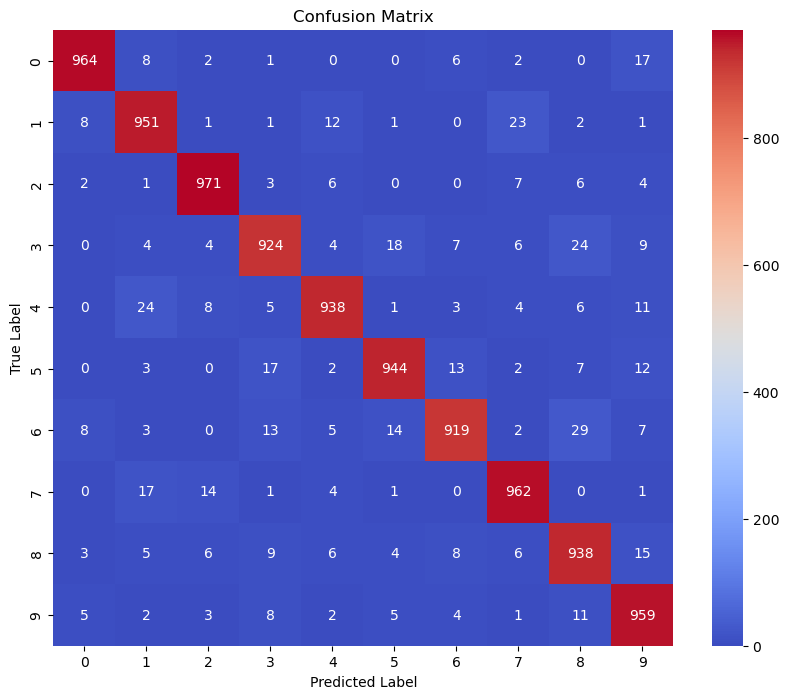

In [41]:
# Visualize the confusion matrix using seaborn heatmap
conf_matrix = confusion_matrix(true_classes, predicted_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='coolwarm', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


<hr style="border:1px dashed #888;">

**Discussion - Test and Evaluate**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
Tensorboard was used during this assigment as it was found to be more practical and showcases what was likely to be used
in industry as it can be accessed across mutlipe runs of the code without needing to retrain.

- Command for tensorboard: tensorboard --logdir CustomCNN_model_0_0/logs

First two screenshots are from 2024 when running a native windows environment.
The second set of screenshots are from 2025 when running from a WSL2 environment. The best model was trained on the 10th Epoch.

All processes have stayed the same yet the accuracy has drastically increased - the first attempt is actually learning in the new WSL2 environment.
Please refer to the company document for further analysis of this attempts findings.

</div>

2024 Native Windows Environment with GPU enabled

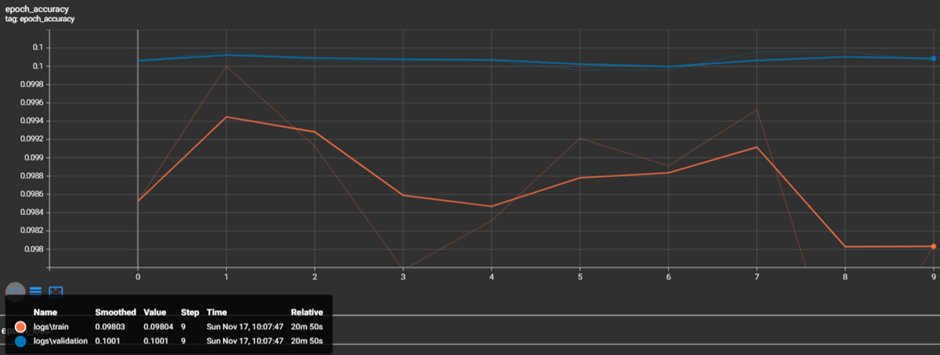
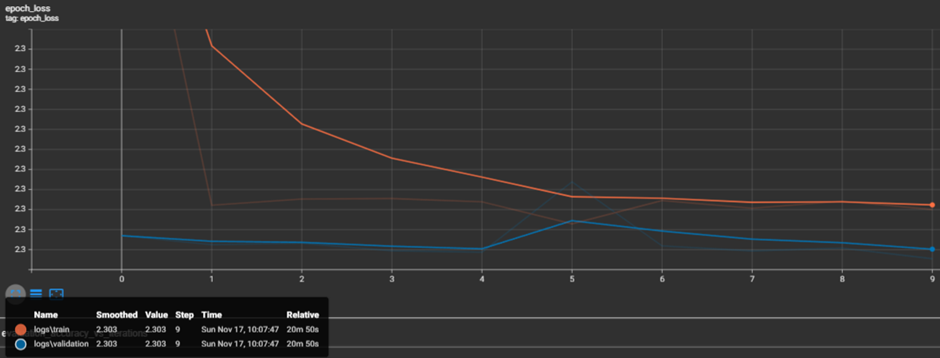

2025 WSL2 Environment with GPU enabled

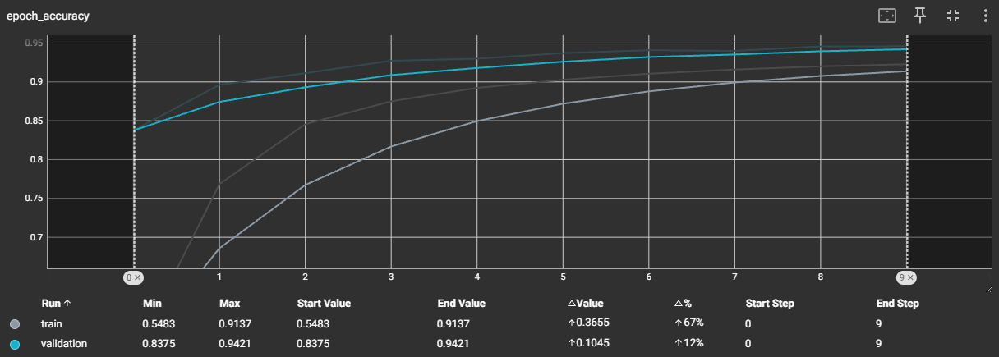
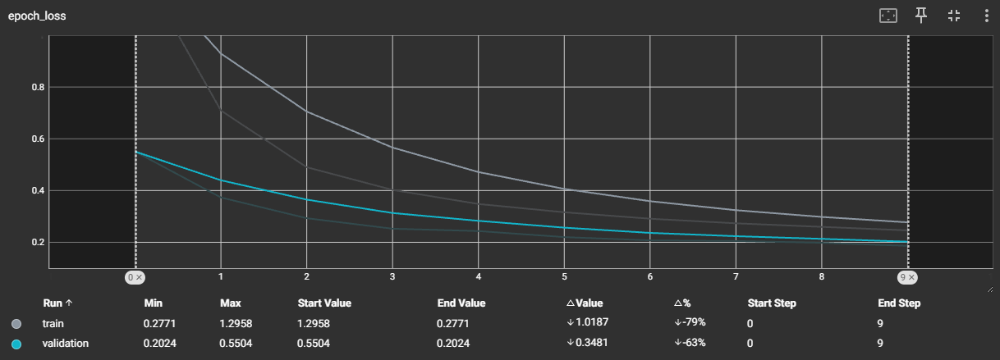
<hr style="border:1px dashed #888;">


# <a id='toc7_'></a>[Attempt 2](#toc0_)


<hr style="border:1px dashed #888;">

**Analysis Plan**

<div style="max-width: 700px; line-height: 1.5; text-align: justify;">

- CustomCNN
- Balanced class data of 100,000 entries
- Train 80%
- Val 10%
- Test 10%
- 32 x 32 RGB png images
- Upscaled to 224x224
- Sharpended to radius=15 and amount=2

|Item  |Description  |
|---------|---------|
|Document    |   MAPrinsloo - SVHN Image Classification CNN.pdf|
|Section     |      "5 Interpretation of Results"    |
|Page     |     22    |

</div>


<hr style="border:1px dashed #888;">

## <a id='toc7_1_'></a>[Datagen](#toc0_)

In [42]:
#-----------------------------------------------------------------------------------------------------------------------#
# Datagens
# Create an instance of ImageDataGenerator for training data
train_datagen = ImageDataGenerator(
    rescale=1./255,  # Normalize pixel values to [0, 1]
    # Add other augmentations if needed
)

# Create an instance of ImageDataGenerator for validation data
val_datagen = ImageDataGenerator(
    rescale=1./255  # Same normalization as the training data
)

# Create an instance of ImageDataGenerator for validation data
test_datagen = ImageDataGenerator(
    rescale=1./255  # Same normalization as the training data
)

# Training generator (loading from the 'train' directory)
train_generator = train_datagen.flow_from_directory(
    'split_data_15_2/train',          # Path to your training images
    target_size=(224, 224),     # Resize all images to this size
    batch_size=32,
    class_mode='categorical'    # For multiclass classification
)

# Validation generator (loading from the 'validation' directory)
validation_generator = val_datagen.flow_from_directory(
    'split_data_15_2/val',     # Path to your validation images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical'    # Same class_mode as training
)

# Test generator (loading from the 'validation' directory)
test_generator = test_datagen.flow_from_directory(
    'split_data_15_2/test',     # Path to your validation images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical'    # Same class_mode as training
)

Found 80000 images belonging to 10 classes.
Found 10000 images belonging to 10 classes.
Found 10000 images belonging to 10 classes.


## <a id='toc7_2_'></a>[Compiling Custom CNN](#toc0_)

In [43]:
#-----------------------------------------------------------------------------------------------------------------------#
# Creating Custom CNN
# Define CNN architecture
# https://medium.com/@sanjay_dutta/designing-your-own-convolutional-neural-network-cnn-model-a-step-by-step-guide-for-beginners-4e8b57836c81
checkpoint_dir = 'CustomCNN_model_15_2/checkpoints'
log_dir = 'CustomCNN_model_15_2/logs'
num_classes = 10
CustomCNN_model_15_2 = models.Sequential([
    # Convolutional Layer 1
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D((2, 2)),
    
    # Convolutional Layer 2
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Convolutional Layer 3
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    
    # Flatten the results to feed into a fully connected layer
    layers.Flatten(),
    
    # Fully Connected Layer 1 (Hidden Layer)
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),  # Dropout for regularization
    
    # Fully Connected Layer 2 (Hidden Layer)
    layers.Dense(64, activation='relu'),
    
    # Output Layer (Softmax for multiclass classification)
    layers.Dense(num_classes, activation='softmax')  # 10 classes
])

# Create directories if they don't exist
os.makedirs(checkpoint_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)

# Callback to save the best model (based on validation accuracy)
checkpoint_callback = ModelCheckpoint(
    filepath=os.path.join(checkpoint_dir, 'best_model.h5'),  # Save path for the best model
    monitor='val_loss',  # Monitor validation loss (or accuracy)
    save_best_only=True,  # Save only the best model based on the monitor metric
    mode='min',  # 'min' means we want to minimize the val_loss (or val_accuracy if monitoring accuracy)
    verbose=1
)

# Callback to use TensorBoard for logging training process
tensorboard_callback = TensorBoard(
    log_dir=log_dir,  # Path to store TensorBoard logs
    histogram_freq=1,  # Log histograms for layers
    write_graph=True,  # Write the graph
    write_images=True,  # Write the model's image to TensorBoard
)

# Model compiling
CustomCNN_model_15_2.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']  # Add precision, recall, and f1 score
)

CustomCNN_model_15_2.summary()

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 86528)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │    11,075,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,177,866 (42.64 MB)

 Trainable params: 11,177,866 (42.64 MB)

 Non-trainable params: 0 (0.00 B)

## <a id='toc7_3_'></a>[Training](#toc0_)

In [44]:
#-----------------------------------------------------------------------------------------------------------------------#
# Model training with callbacks
CustomCNN_model_history = CustomCNN_model_15_2.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    callbacks=[checkpoint_callback, tensorboard_callback]  # Include both callbacks
)

/home/maprinsloo/miniconda3/envs/tf-gpu-wsl/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 0.6124 - loss: 1.1004
Epoch 1: val_loss improved from None to 0.25800, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 183s 72ms/step - accuracy: 0.7802 - loss: 0.6636 - val_accuracy: 0.9252 - val_loss: 0.2580
Epoch 2/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.8903 - loss: 0.3563
Epoch 2: val_loss improved from 0.25800 to 0.20725, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 148s 59ms/step - accuracy: 0.8954 - loss: 0.3430 - val_accuracy: 0.9380 - val_loss: 0.2073
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - accuracy: 0.9112 - loss: 0.2887
Epoch 3: val_loss improved from 0.20725 to 0.20620, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 144s 57ms/step - accuracy: 0.9113 - loss: 0.2887 - val_accuracy: 0.9385 - val_loss: 0.2062
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - accuracy: 0.9222 - loss: 0.2498
Epoch 4: val_loss improved from 0.20620 to 0.18724, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 137s 55ms/step - accuracy: 0.9224 - loss: 0.2503 - val_accuracy: 0.9445 - val_loss: 0.1872
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - accuracy: 0.9299 - loss: 0.2259
Epoch 5: val_loss improved from 0.18724 to 0.17547, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 141s 57ms/step - accuracy: 0.9298 - loss: 0.2266 - val_accuracy: 0.9505 - val_loss: 0.1755
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.9358 - loss: 0.2042
Epoch 6: val_loss improved from 0.17547 to 0.17176, saving model to CustomCNN_model_15_2/checkpoints/best_model.h5


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 148s 59ms/step - accuracy: 0.9340 - loss: 0.2083 - val_accuracy: 0.9486 - val_loss: 0.1718
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.9392 - loss: 0.1897
Epoch 7: val_loss did not improve from 0.17176
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 135s 54ms/step - accuracy: 0.9390 - loss: 0.1906 - val_accuracy: 0.9457 - val_loss: 0.1904
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - accuracy: 0.9458 - loss: 0.1712
Epoch 8: val_loss did not improve from 0.17176
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 142s 57ms/step - accuracy: 0.9446 - loss: 0.1757 - val_accuracy: 0.9503 - val_loss: 0.1739
Epoch 9/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - accuracy: 0.9492 - loss: 0.1583
Epoch 9: val_loss did not improve from 0.17176
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 137s 55ms/step - accuracy: 0.9471 - loss: 0.1665 - val_accuracy: 0.9422 - val_loss: 0.2061
Epoch 10/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - accuracy: 0.9506 - loss: 0.1524
Epoch 10: val_

## <a id='toc7_4_'></a>[Test and Evaluate](#toc0_)

In [45]:
# Load the best model from the checkpoint
best_model_path = 'CustomCNN_model_15_2/checkpoints/best_model.h5'  # Path to the best model checkpoint
best_model = load_model(best_model_path)

# Test generator (loading from the 'test' directory)
test_generator = test_datagen.flow_from_directory(
    'split_data_15_2/test',     # Path to your test images
    target_size=(224, 224),     # Same size as training images
    batch_size=32,
    class_mode='categorical',    # Same class_mode as training
    shuffle=False  # Important: Set shuffle=False to maintain the order of the test data
)

# Evaluate the best model on the test data
test_loss, test_accuracy = best_model.evaluate(test_generator)

print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

# Get predictions from the best model
predictions = best_model.predict(test_generator)

# Convert predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Get true labels
true_classes = test_generator.classes

# Generate classification report (precision, recall, F1 score)
report = classification_report(true_classes, predicted_classes, target_names=test_generator.class_indices.keys())

print("Classification Report:")
print(report)

Found 10000 images belonging to 10 classes.
313/313 ━━━━━━━━━━━━━━━━━━━━ 23s 72ms/step - accuracy: 0.9482 - loss: 0.1764
Test Loss: 0.17642195522785187
Test Accuracy: 0.948199987411499
313/313 ━━━━━━━━━━━━━━━━━━━━ 16s 51ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.97      0.97      1000
           1       0.94      0.94      0.94      1000
           2       0.96      0.96      0.96      1000
           3       0.92      0.94      0.93      1000
           4       0.94      0.95      0.95      1000
           5       0.96      0.95      0.95      1000
           6       0.96      0.93      0.94      1000
           7       0.97      0.95      0.96      1000
           8       0.94      0.94      0.94      1000
           9       0.94      0.94      0.94      1000

    accuracy                           0.95     10000
   macro avg       0.95      0.95      0.95     10000
weighted avg       0.95      0.95      0.95  

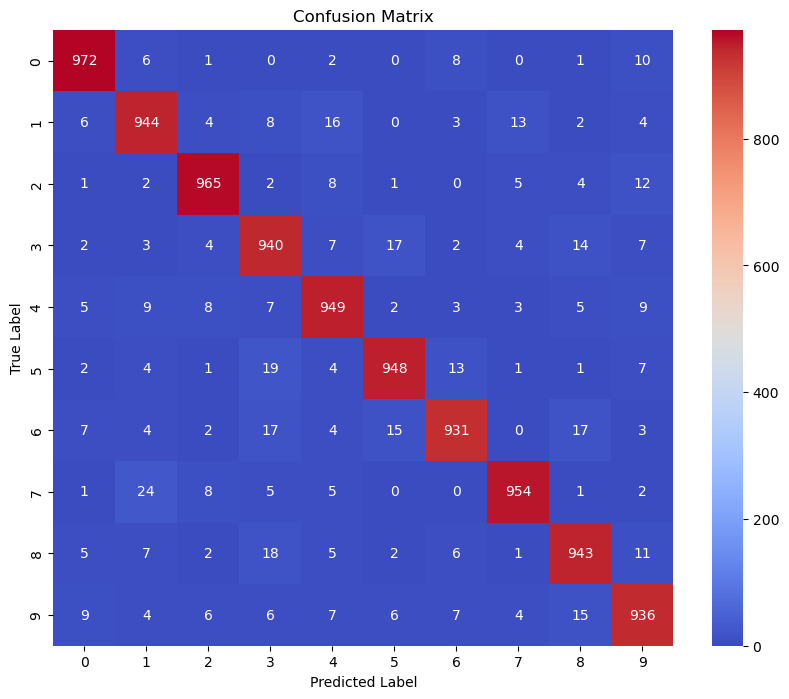

In [46]:
# Visualize the confusion matrix using seaborn heatmap
conf_matrix = confusion_matrix(true_classes, predicted_classes)

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='coolwarm', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

<hr style="border:1px dashed #888;">

**Discussion - Test and Evaluate**
<div style="max-width: 700px; line-height: 1.5; text-align: justify;">
Tensorboard was used during this assigment as it was found to be more practical and showcases what was likely to be used
in industry as it can be accessed across mutlipe runs of the code without needing to retrain.

- Command for tensorboard: tensorboard --logdir CustomCNN_model_15_2/logs
  
First two screenshots are from 2024 when running a native windows environment.
The second set of screenshots are from 2025 when running from a WSL2 environment. The best model was trained on the 7th Epoch.

Please refer to the company document for further analysis of this attempts findings.


</div>




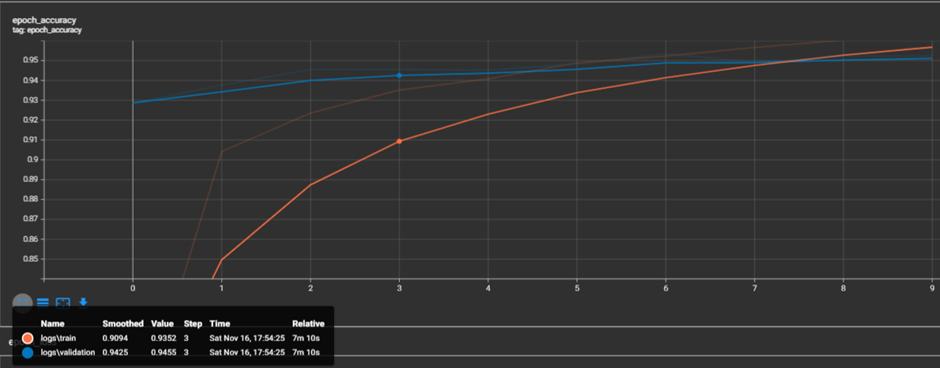
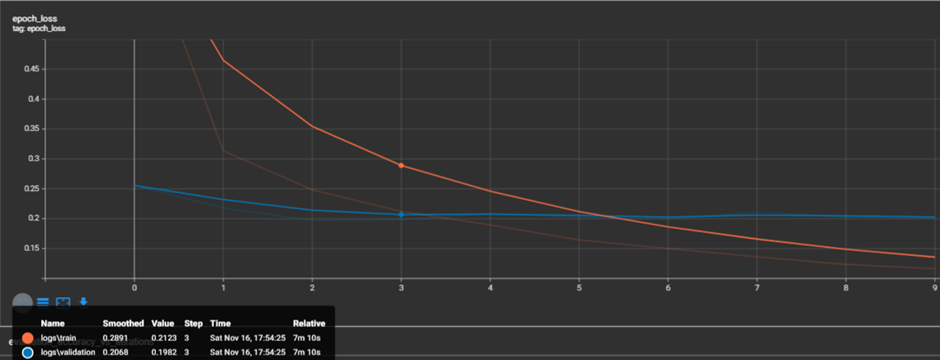

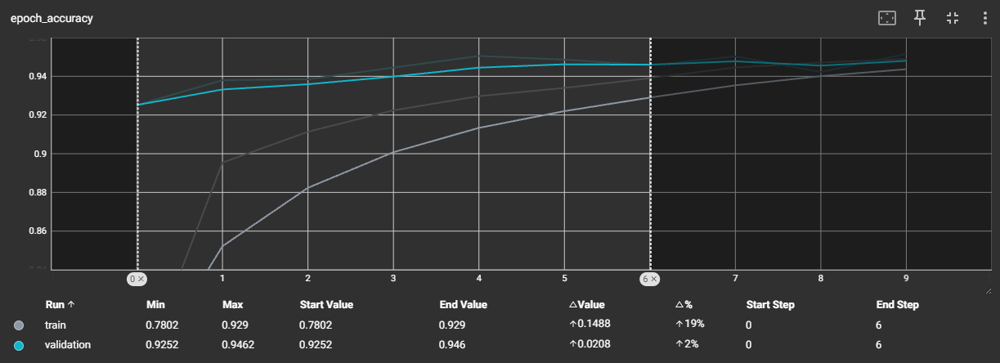
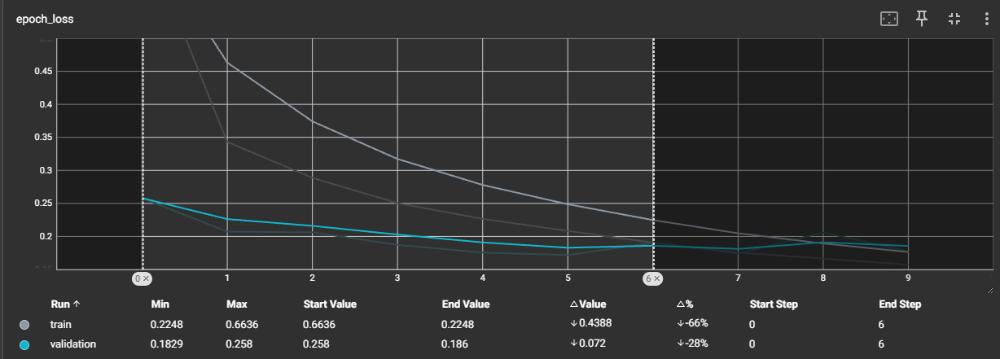

<hr style="border:1px dashed #888;">

#
----------